In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image, ImageDraw # pip3 install Pillow
import json
import os

In [2]:
rel_data_path = "../sample_data/"
test_name = "2020-03-11+15-04-20+NAB972-Seite+Rechts+Unten-_00053"

test_picture = Image.open(os.path.join(rel_data_path, test_name + ".jpg"))
with open(os.path.join(rel_data_path, test_name + ".json"), 'r') as f:
    test_labels = json.load(f)

In [5]:
def chunkify(im_pil: Image, width: int, height: int, blocksize: int):
    """
        Cuts the image into blocksize**2 blocks of size blocksize*blocksize
    """
    assert width%blocksize == 0 and height%blocksize == 0
    im = np.array(test_picture.resize((width, height), Image.LANCZOS))
    # generates indices for the blocks
    xs = np.arange(im.shape[0]).reshape(-1, blocksize)
    ys = np.arange(im.shape[1]).reshape(-1, blocksize)
    
    return np.array([im[x][:, y] for x in xs for y in ys])


def chunkify_np(im_np: np.array, width: int, height: int, blocksize: int):
    """
        Cuts the image into blocksize**2 blocks of size blocksize*blocksize
    """
    assert width%blocksize == 0 and height%blocksize == 0
    im = cv2.resize(im_np, dsize=(width, height), interpolation=cv2.INTER_LANCZOS4)
    # generates indices for the blocks
    xs = np.arange(im.shape[0]).reshape(-1, blocksize)
    ys = np.arange(im.shape[1]).reshape(-1, blocksize)
    return np.array([im[x][:, y] for x in xs for y in ys])

In [6]:
im_np = np.array(test_picture)
ims = chunkify_np(im_np, 4221, 2814, 469) # To know where these values come from, check out Chunkify.ipynb

In [7]:
ims.shape

(54, 469, 469, 3)

In [14]:
np.newaxis is None

True

In [15]:
ims.shape

(54, 469, 469, 3)

In [ ]:
(5000, 54, w, h, c) --> (5000*54, w, h, c)

In [26]:
np.any(ims[..., 2] == 128, axis=(-1,-2)).shape

# BLAS
# Basic Linear Algebra Subsystem
# LAPACK
# OpenBLAS
# mkl Math kernel Library


(54,)

In [32]:
for chunk in ims:
    scratch_layer = chunk[:, :, 2]
    scratch = False
    for x in range(scratch_layer.shape[0]):
        for y in range(scratch_layer.shape[1]):
            if scratch_layer[x, y] == 128:
                scratch = True
                break
        if scratch:
            break
    print(scratch)

True
False
False
True
True
True
True
True
True
False
False
True
True
False
False
True
False
False
True
True
True
True
True
True
True
True
False
True
True
True
True
True
True
False
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


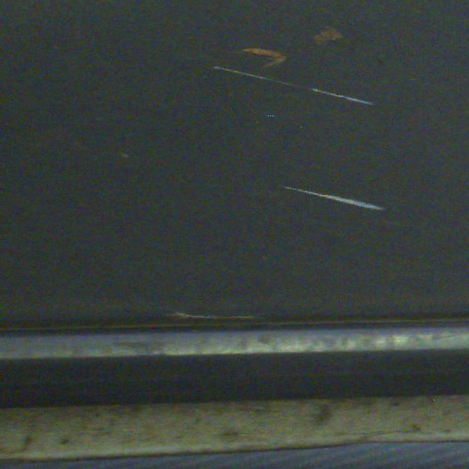

In [7]:
Image.fromarray(ims[27])

In [8]:
test_labels

{'version': '3.21.1',
 'flags': {},
 'shapes': [{'label': 'deformation',
   'line_color': None,
   'fill_color': None,
   'points': [[1239.6551724137933, 1905.1724137931035],
    [1337.9310344827586, 1910.344827586207],
    [1427.5862068965519, 1915.5172413793105],
    [1693.103448275862, 1898.2758620689656],
    [1679.3103448275863, 1944.8275862068967],
    [1553.448275862069, 1929.3103448275863],
    [1470.689655172414, 1927.5862068965519],
    [1439.6551724137933, 1939.6551724137933],
    [1415.5172413793105, 1920.689655172414],
    [1400.0, 1925.8620689655174],
    [1355.1724137931035, 1920.689655172414],
    [1298.2758620689656, 1913.793103448276],
    [1274.1379310344828, 1931.034482758621],
    [1225.8620689655174, 1931.034482758621]],
   'shape_type': 'polygon',
   'flags': {}},
  {'label': 'corrosion',
   'line_color': None,
   'fill_color': None,
   'points': [[1756.8965517241381, 1294.8275862068967],
    [1781.034482758621, 1320.689655172414],
    [1775.8620689655174, 1343.1

In [10]:
mask = Image.new('L', (test_labels['imageWidth'], test_labels['imageHeight']))
draw = ImageDraw.Draw(mask)
for shape in test_labels['shapes']:
    if shape['shape_type'] != 'polygon':
        continue 
    draw.polygon([tuple(elem) for elem in shape['points']], fill=128)
del draw
np.array(mask).shape

(3000, 4096)

In [10]:
im_masked = np.concatenate((np.array(test_picture), (np.array(mask)+128)[..., None]), axis=2)
im_masked = im_masked[:,:,[3,0,1,2]]

In [11]:
np.array(mask).max()

128

In [12]:
im_masked.shape

(3000, 4096, 4)

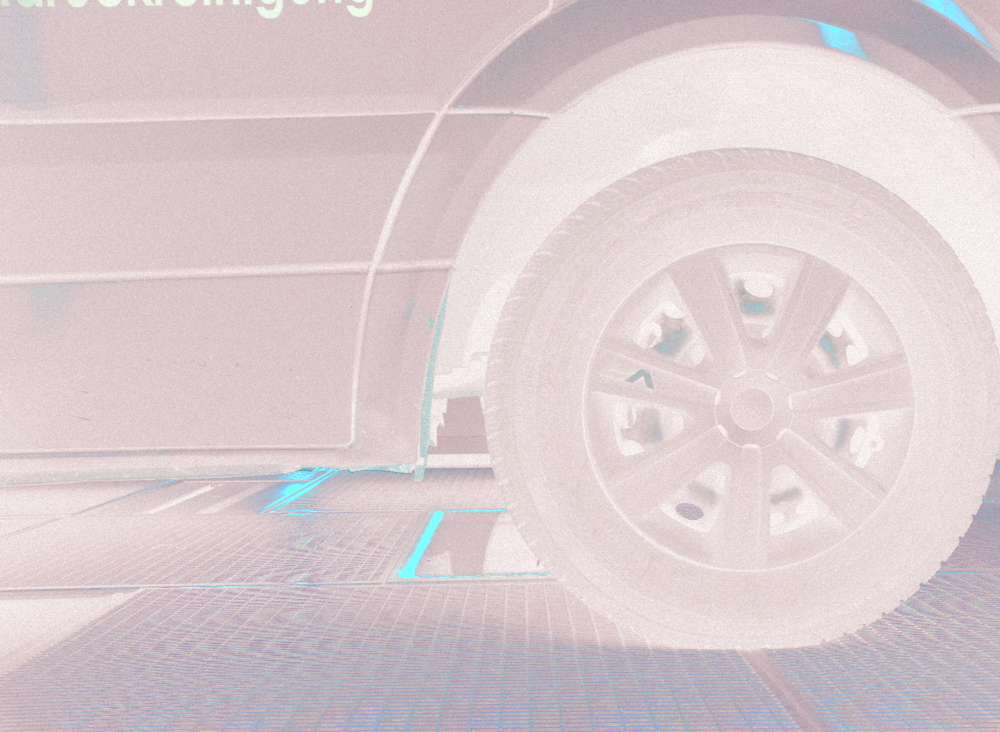

In [13]:
Image.fromarray(im_masked)

In [15]:
# TODO: use xarrays

In [36]:
def shapeToMask(width, height, json_shape) -> np.array:
    mask = Image.new('L', (width, height))
    draw = ImageDraw.Draw(mask)
    if shape['shape_type'] != 'polygon':
        raise ValueError("Found non polygon shape")
    draw.polygon([tuple(elem) for elem in shape['points']], fill=128)
    del draw
    return np.array(mask)[..., None]

def createMasks(json_labels):
    label_dict = {e['label']: [] for e in json_labels['shapes']}
    width, height = json_labels['imageWidth'], json_labels['imageHeight']
    for shape in json_labels['shapes']:
        label_dict[shape['label']].append(shapeToMask(width, height, shape))
    return label_dict

def concatMasks(masks) -> np.array:
    arrays = []
    for e in masks.values():
        arrays.extend(e)
    return np.concatenate(tuple(arrays), axis=2)

In [37]:
createMasks(test_labels).keys(), [e.shape for l in createMasks(test_labels).values() for e in l]

(dict_keys(['deformation', 'corrosion', 'misc']),
 [(3000, 4096, 1), (3000, 4096, 1), (3000, 4096, 1)])

In [38]:
concatMasks(createMasks(test_labels)).shape

(3000, 4096, 3)

In [ ]:
{
    "scratch": [np3, np4 ...],
    "deformation": [np1, np2, ...]
}

[np1, np2, np3, np4]

npMask.shape = (w, h, 4)
np.sum(npMask, axis=2).shape == (w, h)